In [1]:
using Plots, ColorSchemes, Statistics
Plots.default(fontfamily="Computer Modern")

include("src/HPMC.jl")
using .HPMC

In [2]:
function plotsim(sim, filepath)
    modangle = 2π / sim.particles.sidenum
    colors = mod.(Array(sim.particles.angles), modangle) / modangle
    p1 = plot(sim.particles, colors, title="Orientation")

    colors = Array(abs.(sim.recorders[1].values[end]))
    p2 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=4\$")

    colors = Array(abs.(sim.recorders[2].values[end]))
    p3 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=6\$")

    colors = Array(abs.(sim.recorders[3].values[end]))
    p4 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=8\$")

    p = plot!(p1, p2, p3, p4, layout=(2, 2), size=(500, 500))
    savefig(p, filepath)
    display(p)
end

function plotorders(sim, filepath)
    p1 = plot(sim.recorders[end].times, abs.(sim.recorders[end].values),
              ylabel="Mean Orientation")
    p2 = plot(sim.recorders[1].times,
              mean.([abs.(order) for order in sim.recorders[1].values]),
              ylabel="Mean \$k\$-atic Order, \$k=4\$")
    p3 = plot(sim.recorders[2].times,
              mean.([abs.(order) for order in sim.recorders[2].values]),
              ylabel="Mean \$k\$-atic Order, \$k=6\$")
    p4 = plot(sim.recorders[3].times,
              mean.([abs.(order) for order in sim.recorders[3].values]),
              ylabel="Mean \$k\$-atic Order, \$k=8\$")
    p = plot!(p1, p2, p3, p4, layout=(2, 2), legend=false,
              xlabel="t", color=:mediumblue, size=(800, 600))
    savefig(p, filepath)
    display(p)
end

plotorders (generic function with 1 method)

In [3]:
n = 1024

1024

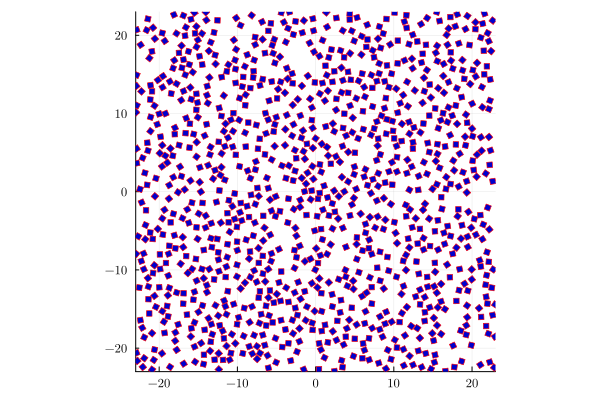

In [4]:
sim = HPMC.HPMCSimulation(n, 4, 0.5, (ceil(Int, √(2n)), ceil(Int, √(2n))), gpu=true)
HPMC.crystallize!(sim.particles)
sim.move_radius = 0.25
sim.rotation_span = π / 8
HPMC.run!(sim, 5n)
plot(sim.particles)

In [5]:
p_area = HPMC.particlearea(sim.particles)
initial_area_fraction = HPMC.count(sim.particles) * p_area / HPMC.boxarea(sim.particles)

0.24196597353497165

In [6]:
final_area_fraction = 0.8
target_sidelen = Float32(√(HPMC.particlecount(sim.particles) * p_area / final_area_fraction))

25.298222f0

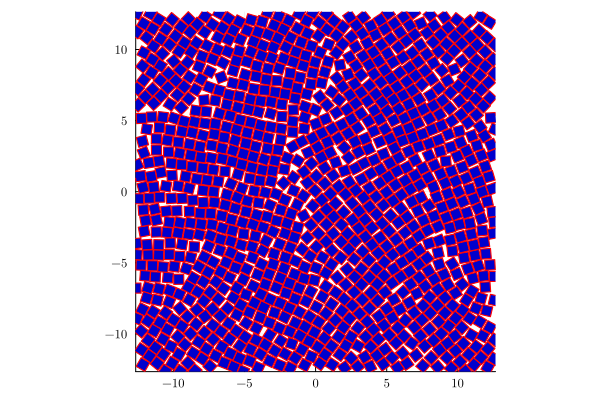

In [7]:
push!(sim.updaters, HPMC.MoveSizeTuner(
    t -> t % 10 == 0, 0.5; max_move_radius=0.25, max_rotation_span=π/8))
push!(sim.updaters, HPMC.ForcefulCompressor(
    t -> t % 20 == 0, (target_sidelen, target_sidelen)))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 4))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 6))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 8))
push!(sim.recorders, HPMC.GlobalParamRecorder(
    t -> t % (n ÷ 20) == 0, "orient"))
HPMC.run!(sim, 40n)
plot(sim.particles, ratio=:equal)

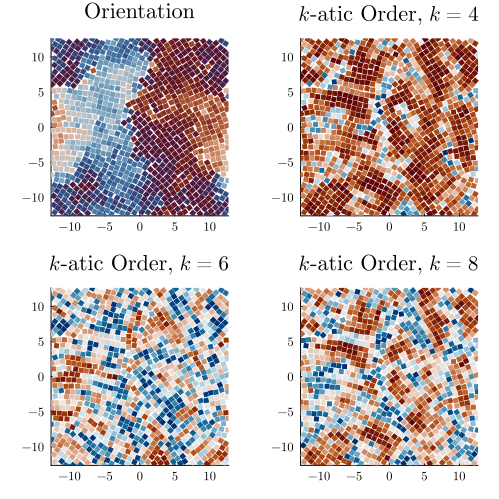

In [8]:
plotsim(sim, "../fig/katic_compress.pdf")

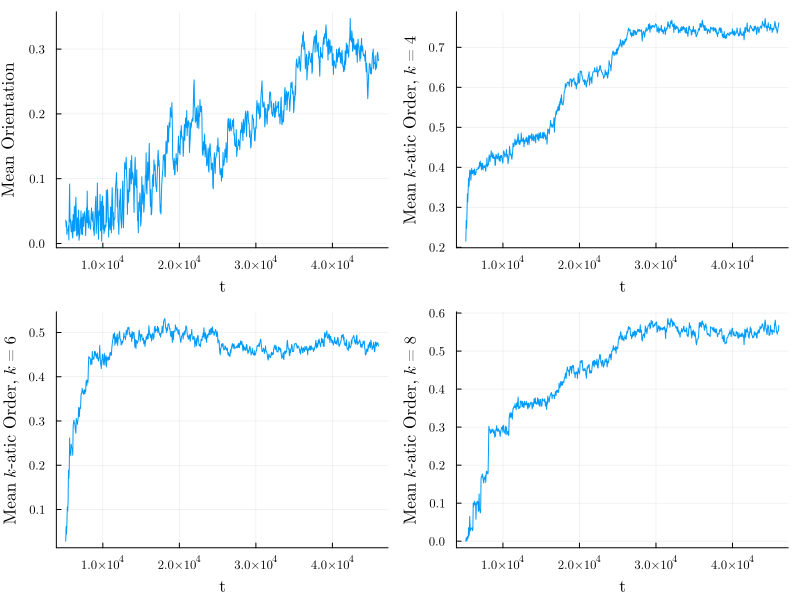

In [9]:
plotorders(sim, "../fig/katic_compress_time.pdf")

In [10]:
empty!(sim.updaters)
empty!(sim.recorders)

Main.HPMC.AbstractRecorder[]

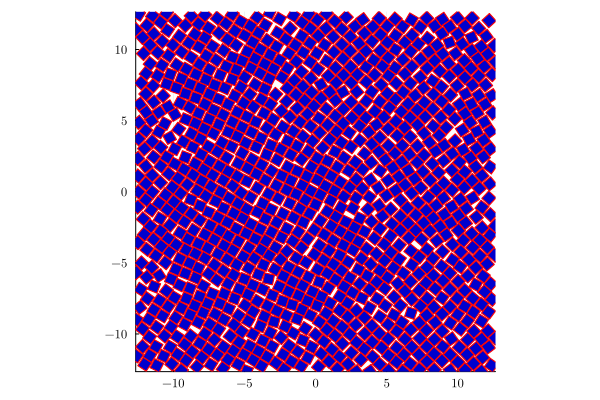

In [11]:
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 4))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 6))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 8))
push!(sim.recorders, HPMC.GlobalParamRecorder(
    t -> t % (n ÷ 20) == 0, "orient"))
HPMC.run!(sim, 100n)
p = plot(sim.particles, ratio=:equal)

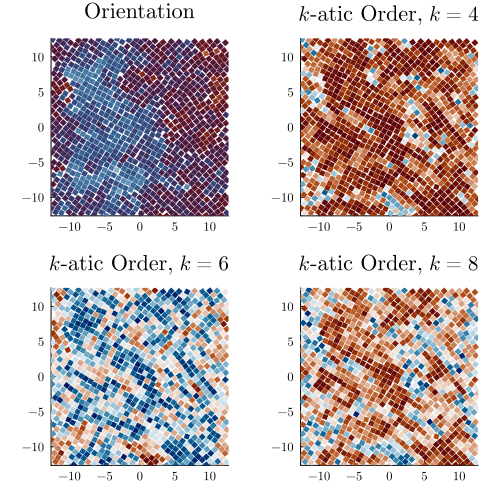

In [12]:
plotsim(sim, "../fig/katic_equilibrium.pdf")

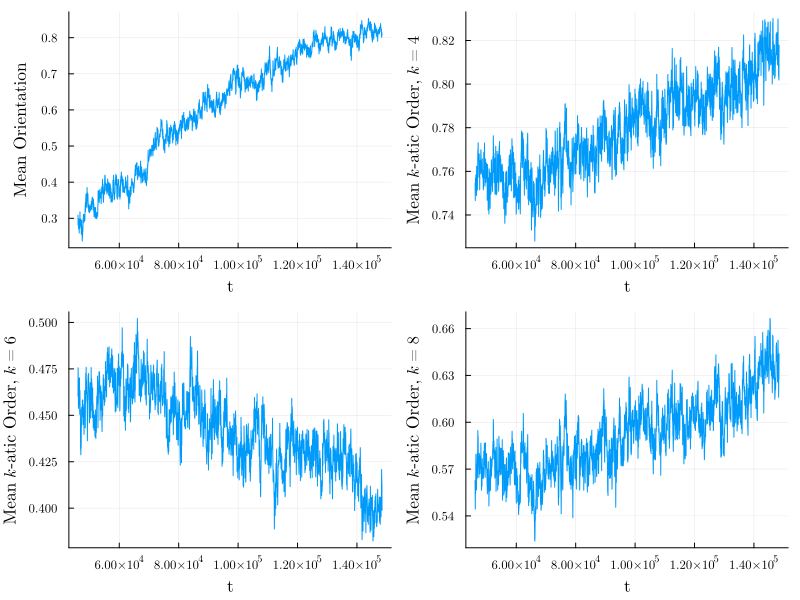

In [13]:
plotorders(sim, "../fig/katic_equilibrium_time.pdf")

In [14]:
function plotsimdisk(sim, r, filepath)
    modangle = 2π / sim.particles.sidenum
    colors = mod.(Array(sim.particles.angles), modangle) / modangle
    p1 = plot(sim.particles, colors, title="Orientation")
    plot!(p1, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = Array(abs.(mean.(sim.recorders[1].values[end])))
    p2 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=4\$")
    plot!(p2, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = Array(abs.(mean.(sim.recorders[2].values[end])))
    p3 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=6\$")
    plot!(p3, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = Array(abs.(mean.(sim.recorders[3].values[end])))
    p4 = plot(sim.particles, colors, ColorSchemes.vik, title="\$k\$-atic Order, \$k=8\$")
    plot!(p4, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    p = plot!(p1, p2, p3, p4, layout=(2, 2), size=(500, 500))
    savefig(p, filepath)
    display(p)
end

plotsimdisk (generic function with 1 method)

In [15]:
n = 1024

1024

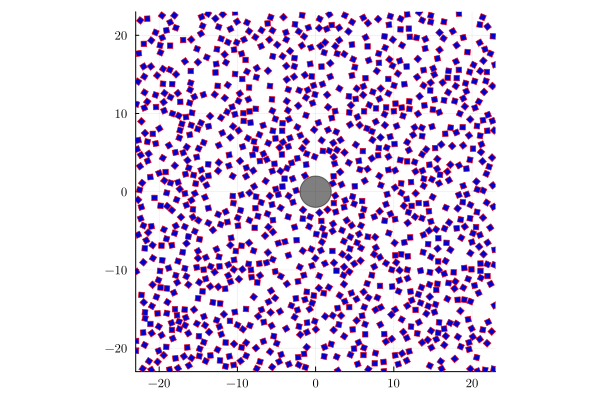

In [16]:
r = 2.0f0
sim = HPMC.HPMCSimulation(n, 4, 0.5, (ceil(√(2n)), ceil(√(2n))), gpu=true)
HPMC.crystallize!(sim.particles, ceil(Int, n + π * (r + sim.particles.radius)^2 / 2),
      (particles, centers) -> (sum((centers .- (0.0f0, 0.0f0)).^2, dims=1)
            .> (r + particles.radius) ^ 2))
sim.move_radius = 0.25
sim.rotation_span = π / 8
push!(sim.constraints, HPMC.DiskWall((0.0f0, 0.0f0), r, (x, y) -> ()))
HPMC.run!(sim, 5n)
p = plot(sim.particles)
θs = collect(0:0.01:2π)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)

In [17]:
p_area = HPMC.particlearea(sim.particles)
initial_area_fraction = (HPMC.particlecount(sim.particles) * p_area
                         / HPMC.boxarea(sim.particles))

0.24196597353497165

In [18]:
final_area_fraction = 0.8
target_sidelen = Float32(√((HPMC.particlecount(sim.particles) * p_area
                            + π * r^2) / final_area_fraction))

25.606794f0

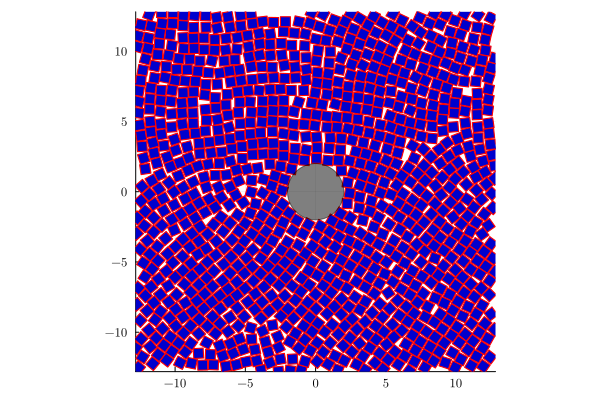

In [19]:
push!(sim.updaters, HPMC.MoveSizeTuner(
    t -> t % 10 == 0, 0.5; max_move_radius=0.25, max_rotation_span=π/8))
push!(sim.updaters, HPMC.ForcefulCompressor(
    t -> t % 20 == 0, (target_sidelen, target_sidelen)))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 4))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 6))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 8))
push!(sim.recorders, HPMC.GlobalParamRecorder(
    t -> t % (n ÷ 20) == 0, "orient"))
HPMC.run!(sim, 40n)
p = plot(sim.particles, ratio=:equal)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)
display(p)

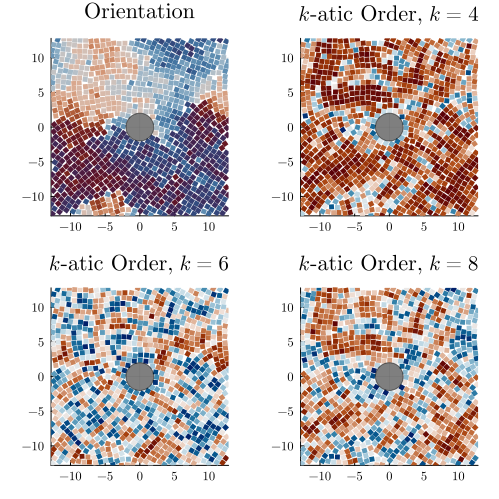

In [20]:
plotsimdisk(sim, r, "../fig/disk_katic_compress.pdf")

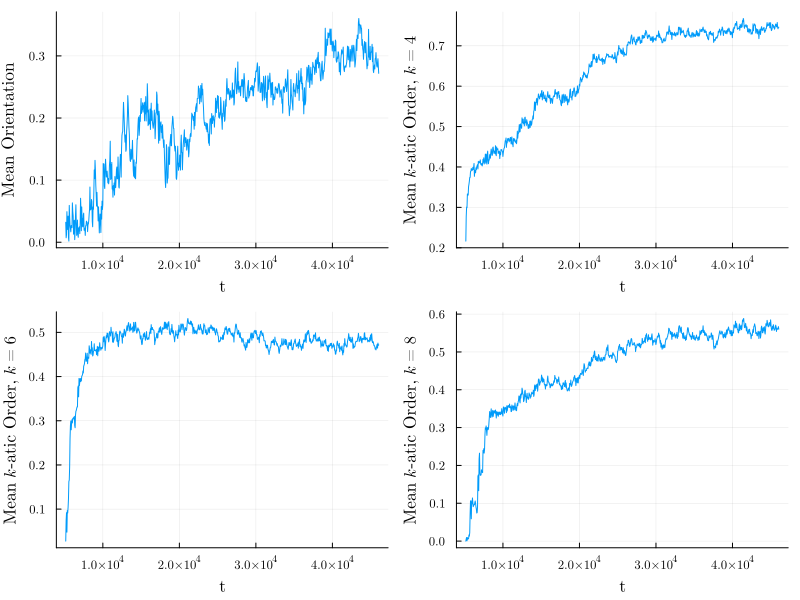

In [21]:
plotorders(sim, "../fig/disk_katic_compress_time.pdf")

In [22]:
empty!(sim.updaters)
empty!(sim.recorders)

Main.HPMC.AbstractRecorder[]

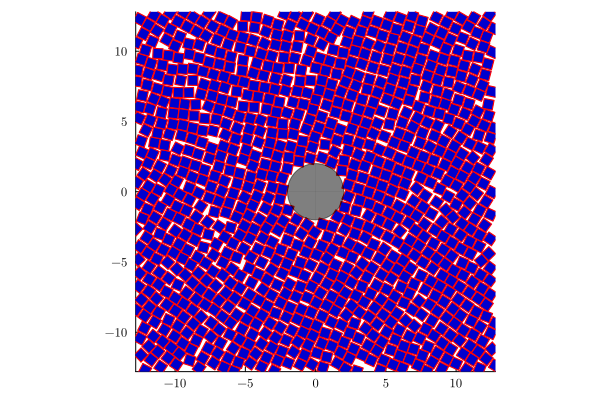

In [23]:
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 4))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 6))
push!(sim.recorders, HPMC.LocalParamRecorder(
    t -> t % (n ÷ 20) == 0, "katic", 8))
push!(sim.recorders, HPMC.GlobalParamRecorder(
    t -> t % (n ÷ 20) == 0, "orient"))
HPMC.run!(sim, 100n)
p = plot(sim.particles)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)
display(p)

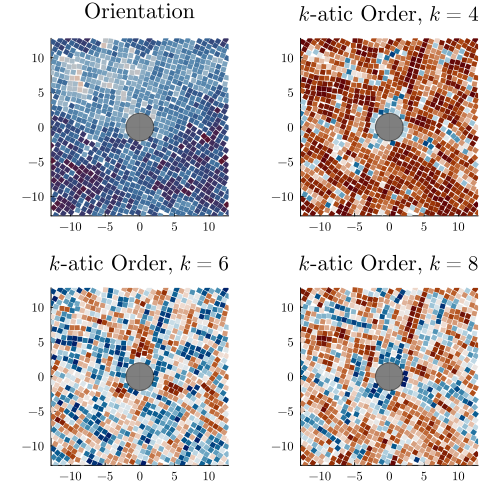

In [24]:
plotsimdisk(sim, r, "../fig/disk_katic_equilibrium.pdf")

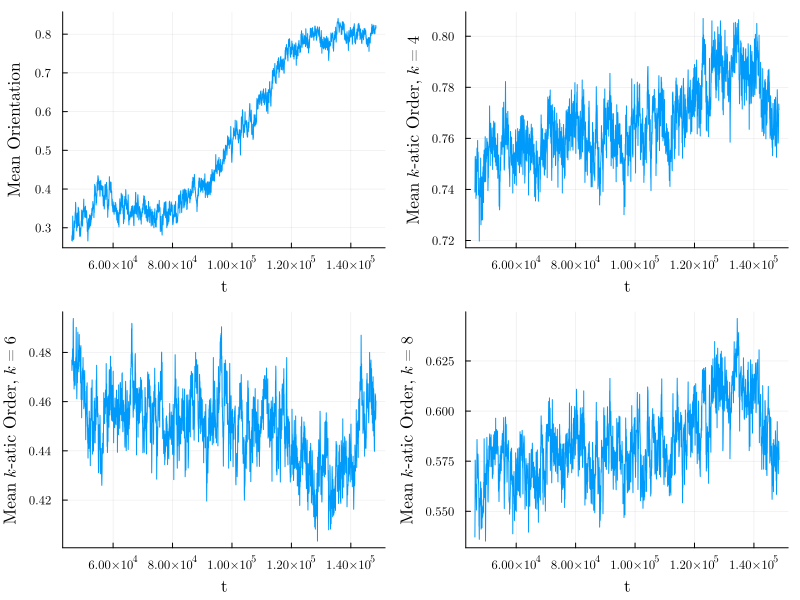

In [25]:
plotorders(sim, "../fig/disk_katic_equilibrium_time.pdf")